# A Diffusion Model from Scratch in Pytorch

本文将构建一个简单的生成轿车图片的Diffusion 模型. 详细的原理请参考视频。


**Sources:**
- Github 实现 [Denoising Diffusion Pytorch](https://github.com/lucidrains/denoising-diffusion-pytorch)
- Diffusion models论文 ([Dhariwal, Nichol, 2021], [Ho et al., 2020] 等.)


## 查看数据集 dataset

这里使用开源的 StandordCars, 该数据集的训练集部分含有约8000张图片。 由于官方已不提供下载。为避免版权纠纷，欢迎私下交流。

In [1]:
import os
os.listdir('/kaggle/input/stanford-cars')
!pwd

/kaggle/working


In [2]:
from distutils.dir_util import copy_tree
from_dir = '/kaggle/input/stanford-cars'
to_dir = '/kaggle/working/stanford_cars'
copy_tree(from_dir,to_dir)


['/kaggle/working/stanford_cars/cars_test/05938.jpg',
 '/kaggle/working/stanford_cars/cars_test/06122.jpg',
 '/kaggle/working/stanford_cars/cars_test/04168.jpg',
 '/kaggle/working/stanford_cars/cars_test/02371.jpg',
 '/kaggle/working/stanford_cars/cars_test/04377.jpg',
 '/kaggle/working/stanford_cars/cars_test/00767.jpg',
 '/kaggle/working/stanford_cars/cars_test/07457.jpg',
 '/kaggle/working/stanford_cars/cars_test/02360.jpg',
 '/kaggle/working/stanford_cars/cars_test/05222.jpg',
 '/kaggle/working/stanford_cars/cars_test/03999.jpg',
 '/kaggle/working/stanford_cars/cars_test/00266.jpg',
 '/kaggle/working/stanford_cars/cars_test/02450.jpg',
 '/kaggle/working/stanford_cars/cars_test/01496.jpg',
 '/kaggle/working/stanford_cars/cars_test/01600.jpg',
 '/kaggle/working/stanford_cars/cars_test/05248.jpg',
 '/kaggle/working/stanford_cars/cars_test/03508.jpg',
 '/kaggle/working/stanford_cars/cars_test/00847.jpg',
 '/kaggle/working/stanford_cars/cars_test/06957.jpg',
 '/kaggle/working/stanford_c

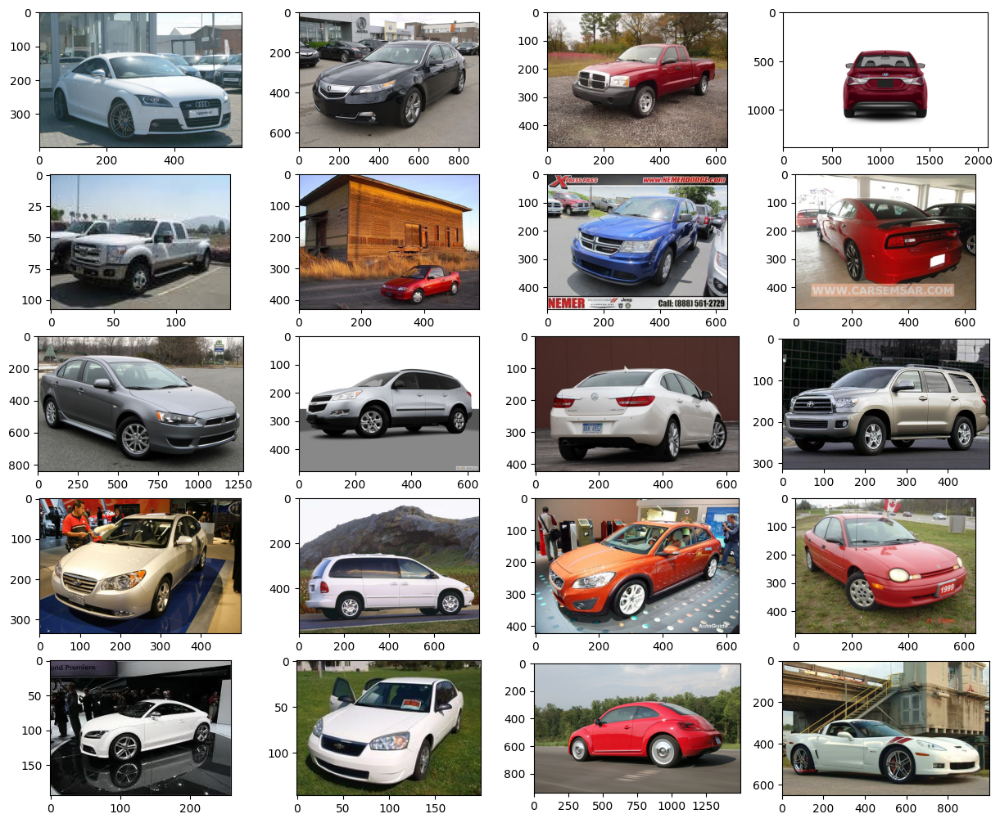

In [3]:
import torch
import torchvision
import matplotlib.pyplot as plt

def show_images(datset, num_samples=20, cols=4):
    """ Plots some samples from the dataset """
    plt.figure(figsize=(15,15))
    for i, img in enumerate(data):
        if i == num_samples:
            break
        plt.subplot(int(num_samples/cols) + 1, cols, i + 1)
        plt.imshow(img[0])

data = torchvision.datasets.StanfordCars(root="/kaggle/working", download=False)
show_images(data)

上面显示了20张jpg图片，后面为了训练的方便，会降图片分辨率以及转为Pytorch的tensor格式。

# 构建 Diffusion 模型

## Step 1: 前向处理 Noise scheduler

在模型训练的时候，输入的是各种噪声程度的汽车图片，输入的不同噪声等级的照片是一次性从数据集里的干净图片生成的，并不是类似扩散过程一点点加噪声。

**Key Takeaways**:
- 噪声水平/方差 可以提前计算好
- 可以使用不同类型的噪声方差调度器
- 可以一次计算得到不同时刻的噪声图片

In [4]:
import torch.nn.functional as F

def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    return torch.linspace(start, end, timesteps)

def get_index_from_list(vals, t, x_shape):
    """
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)

def forward_diffusion_sample(x_0, t, device="cpu"):
    """
    Takes an image and a timestep as input and
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0)
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)


# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

构建训练和测试数据集

In [28]:
from torchvision import transforms
from torch.utils.data import DataLoader
import numpy as np

IMG_SIZE = 128
BATCH_SIZE = 256

def load_transformed_dataset():
    data_transforms = [
        transforms.Resize((IMG_SIZE, IMG_SIZE)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(), # Scales data into [0,1]
        transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ]
    data_transform = transforms.Compose(data_transforms)

    train = torchvision.datasets.StanfordCars(root=".", download=False,
                                         transform=data_transform)

    test = torchvision.datasets.StanfordCars(root=".", download=False,
                                         transform=data_transform, split='test')
    return torch.utils.data.ConcatDataset([train, test])
def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image))

data = load_transformed_dataset()
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

模型扩散（加噪）过程，实际训练的时候，并不是按照下面图片所示的过程加噪的。
加噪的过程是对每个像素点RGB，使用高斯白噪声线性叠加。

/tmp/ipykernel_33/159863166.py:13: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, int(idx/stepsize) + 1)


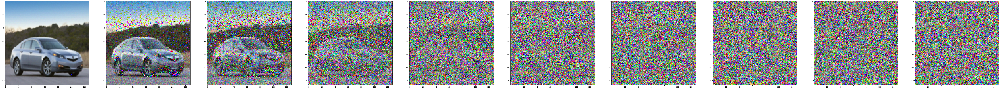

In [37]:
import copy
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(128,128))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t)
    show_tensor_image(img)

## Step 2: 构建反向处理 U-Net

UNets是一种网络结构。


**Key Takeaways**:
- 使用一个简单的 UNet 来预测图片中的噪声
- 输入是带噪的汽车图片，模型输出是该输入图片中的噪声预测值
- 由于参数是在不同扩散时刻共享的，需要将时间戳编码到输入特征，以便于网络感知时间信息
- 时间戳（Timestep）使用 Sinusoidal Embedding
- 模型输出值为单一值--均值，因为方差是固定的

In [7]:
from torch import nn
import math


class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t, ):
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        # TODO: Double check the ordering here
        return embeddings


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 3
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )

        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], \
                                    time_emb_dim) \
                    for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], \
                                        time_emb_dim, up=True) \
                    for i in range(len(up_channels)-1)])

        # Edit: Corrected a bug found by Jakub C (see YouTube comment)
        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.output(x)

model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  62438883


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transfor


**模型可以优化点 :**
- UNet上增加残差连接
- 使用不同的激活函数 SiLU, GWLU, ...
- BatchNormalization
- GroupNormalization
- Attention
- 文本控制的输入等

## Step 3: loss函数

Key Takeaways:

这里使用简单的l1 loss，也可以使用l2等其他的

In [8]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

## 采样（生成图片的过程）
- @torch.no_grad() 以禁止梯度计算，防止内存耗尽
- 因为提前计算好了前向训练时添加噪声的方差值，按照顺序输入带噪图片训练模型，以便梯度反向传递更新模型参数

In [9]:
@torch.no_grad()
def sample_timestep(x, t):
    """
    Calls the model to predict the noise in the image and returns
    the denoised image.
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:
        # As pointed out by Luis Pereira (see YouTube comment)
        # The t's are offset from the t's in the paper
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise

@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = sample_timestep(img, t)
        # Edit: This is to maintain the natural range of the distribution
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            show_tensor_image(img.detach().cpu())
    plt.show()

## 训练

Epoch Progress:   0%|          | 0/1000 [00:00<?, ?it/s]

Epoch 0 | step 000 Loss: 0.8133633136749268 


/tmp/ipykernel_34/3576216167.py:44: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


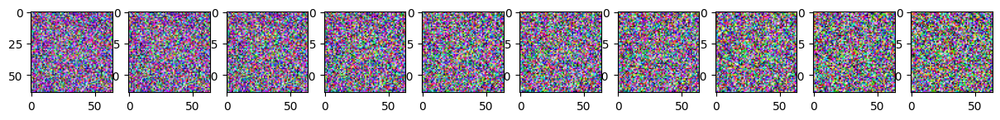

Epoch Progress:   0%|          | 5/1000 [08:45<28:44:10, 103.97s/it]

Epoch 5 | step 000 Loss: 0.1742769479751587 


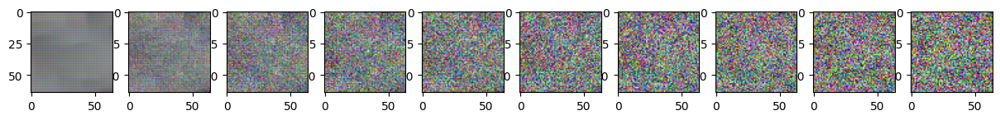

Epoch Progress:   1%|          | 10/1000 [17:24<28:23:03, 103.22s/it]

Epoch 10 | step 000 Loss: 0.16434639692306519 


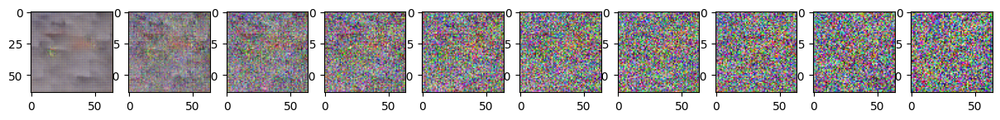

Epoch Progress:   2%|▏         | 15/1000 [26:09<28:37:18, 104.61s/it]

Epoch 15 | step 000 Loss: 0.15695936977863312 


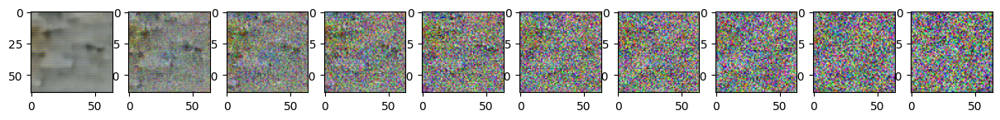

Epoch Progress:   2%|▏         | 20/1000 [34:39<27:41:14, 101.71s/it]

Epoch 20 | step 000 Loss: 0.168574258685112 


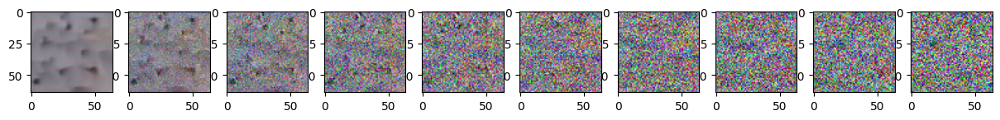

Epoch Progress:   2%|▎         | 25/1000 [43:09<27:29:44, 101.52s/it]

Epoch 25 | step 000 Loss: 0.15774734318256378 


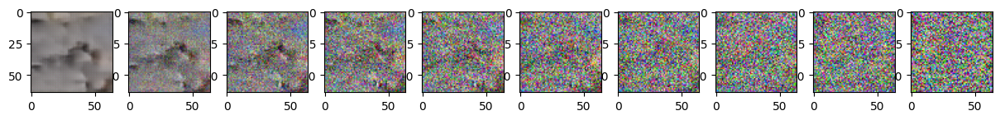

Epoch Progress:   3%|▎         | 30/1000 [51:37<27:16:25, 101.22s/it]

Epoch 30 | step 000 Loss: 0.15479248762130737 


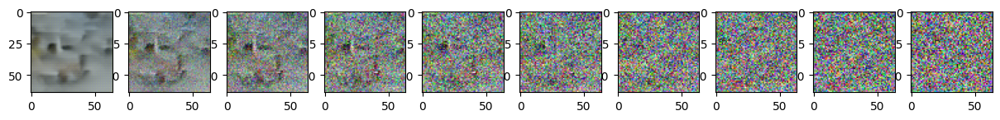

Epoch Progress:   4%|▎         | 35/1000 [1:00:06<27:13:35, 101.57s/it]

Epoch 35 | step 000 Loss: 0.15481804311275482 


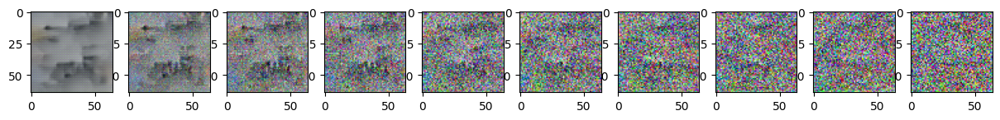

Epoch Progress:   4%|▍         | 40/1000 [1:08:38<27:05:37, 101.60s/it]

Epoch 40 | step 000 Loss: 0.15107843279838562 


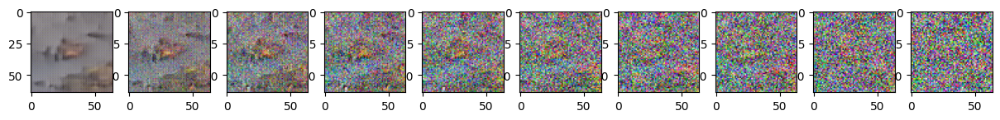

Epoch Progress:   4%|▍         | 45/1000 [1:17:05<26:44:53, 100.83s/it]

Epoch 45 | step 000 Loss: 0.14386950433254242 


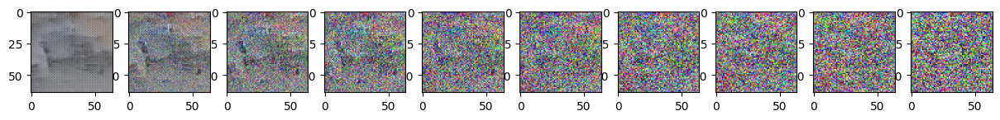

Epoch Progress:   5%|▌         | 50/1000 [1:25:29<26:30:46, 100.47s/it]

Epoch 50 | step 000 Loss: 0.14694595336914062 


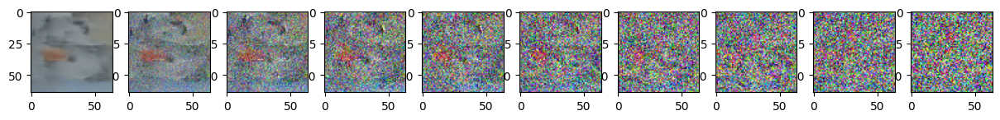

Epoch Progress:   6%|▌         | 55/1000 [1:33:49<26:03:30, 99.27s/it] 

Epoch 55 | step 000 Loss: 0.15033023059368134 


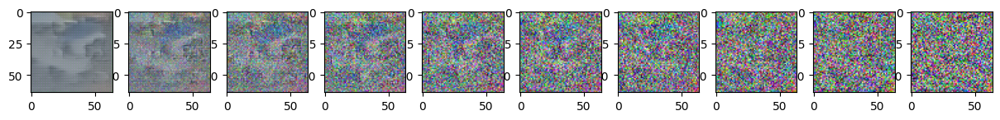

Epoch Progress:   6%|▌         | 60/1000 [1:42:09<26:02:03, 99.71s/it] 

Epoch 60 | step 000 Loss: 0.14869172871112823 


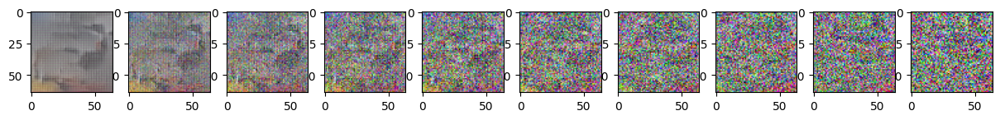

Epoch Progress:   6%|▋         | 65/1000 [1:50:31<25:52:11, 99.61s/it] 

Epoch 65 | step 000 Loss: 0.1398700326681137 


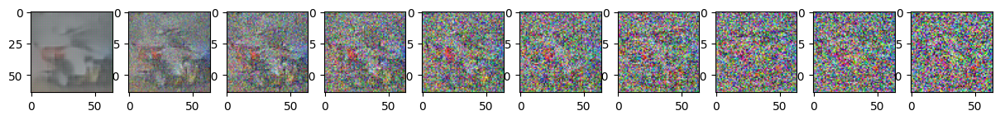

Epoch Progress:   7%|▋         | 70/1000 [1:58:42<25:19:59, 98.06s/it] 

Epoch 70 | step 000 Loss: 0.1356458067893982 


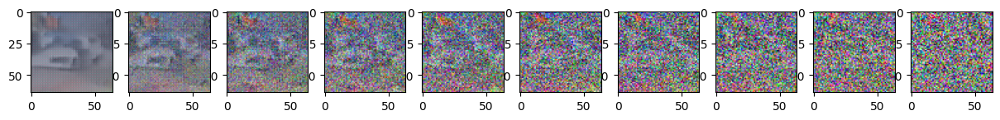

Epoch Progress:   8%|▊         | 75/1000 [2:06:52<25:06:49, 97.74s/it]

Epoch 75 | step 000 Loss: 0.14091363549232483 


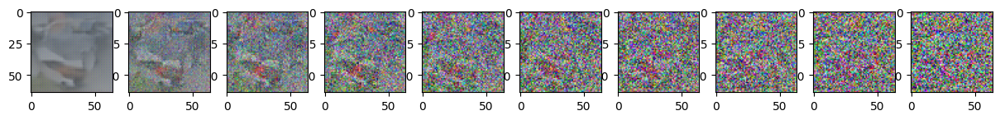

Epoch Progress:   8%|▊         | 80/1000 [2:15:09<25:12:24, 98.64s/it]

Epoch 80 | step 000 Loss: 0.12790623307228088 


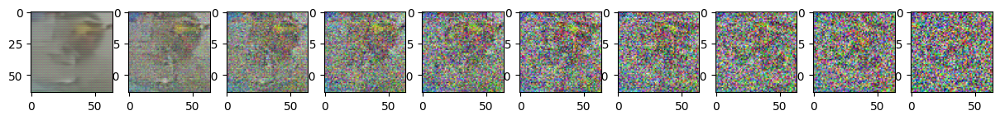

Epoch Progress:   8%|▊         | 85/1000 [2:23:19<24:50:37, 97.75s/it]

Epoch 85 | step 000 Loss: 0.1429886519908905 


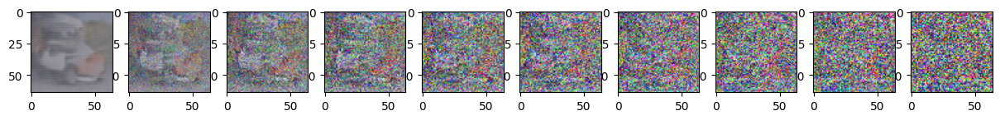

Epoch Progress:   9%|▉         | 90/1000 [2:31:30<24:39:44, 97.57s/it]

Epoch 90 | step 000 Loss: 0.13195548951625824 


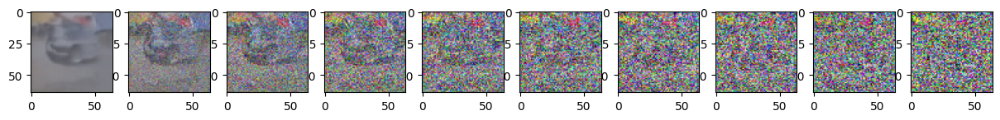

Epoch Progress:  10%|▉         | 95/1000 [2:39:40<24:28:49, 97.38s/it]

Epoch 95 | step 000 Loss: 0.130737766623497 


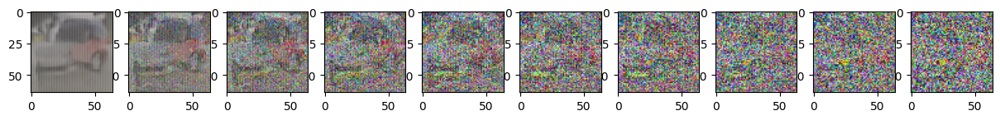

Epoch Progress:  10%|█         | 100/1000 [2:47:55<24:37:15, 98.48s/it]

Epoch 100 | step 000 Loss: 0.1284709870815277 


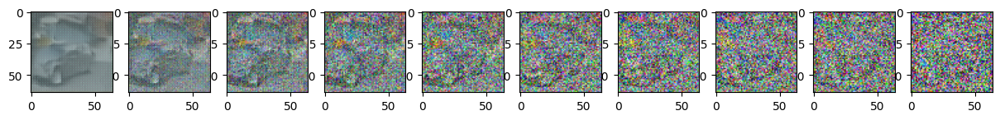

Epoch Progress:  10%|█         | 105/1000 [2:56:16<24:46:49, 99.68s/it] 

Epoch 105 | step 000 Loss: 0.13003051280975342 


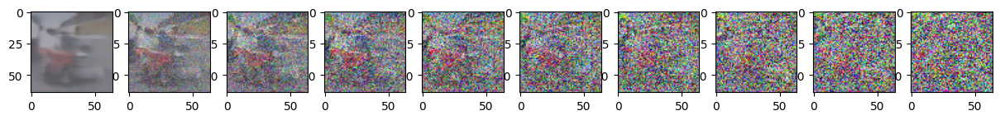

Epoch Progress:  11%|█         | 110/1000 [3:04:58<25:38:05, 103.69s/it]

Epoch 110 | step 000 Loss: 0.13863469660282135 


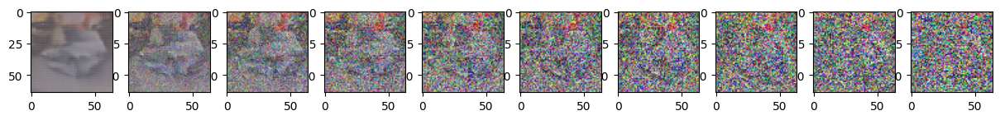

Epoch Progress:  12%|█▏        | 115/1000 [3:13:55<26:09:59, 106.44s/it]

Epoch 115 | step 000 Loss: 0.1406204253435135 


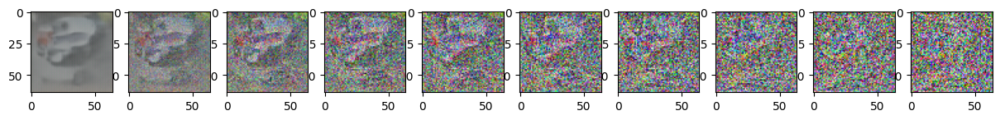

Epoch Progress:  12%|█▏        | 120/1000 [3:22:49<26:00:08, 106.37s/it]

Epoch 120 | step 000 Loss: 0.13737502694129944 


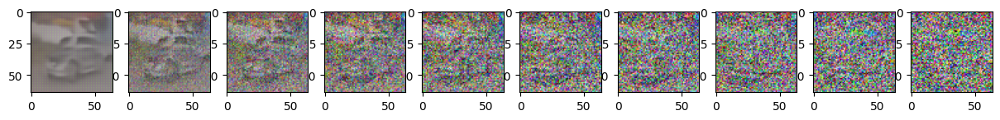

Epoch Progress:  12%|█▎        | 125/1000 [3:31:38<25:36:35, 105.37s/it]

Epoch 125 | step 000 Loss: 0.13156938552856445 


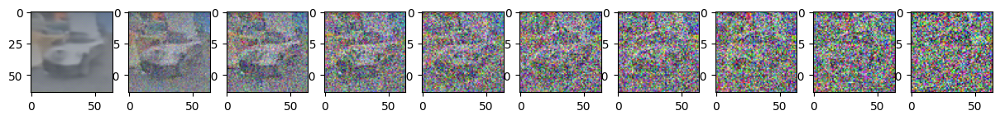

Epoch Progress:  13%|█▎        | 130/1000 [3:40:29<25:33:23, 105.75s/it]

Epoch 130 | step 000 Loss: 0.1346990019083023 


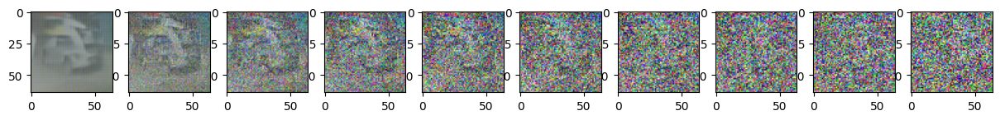

Epoch Progress:  14%|█▎        | 135/1000 [3:49:22<25:27:35, 105.96s/it]

Epoch 135 | step 000 Loss: 0.12849369645118713 


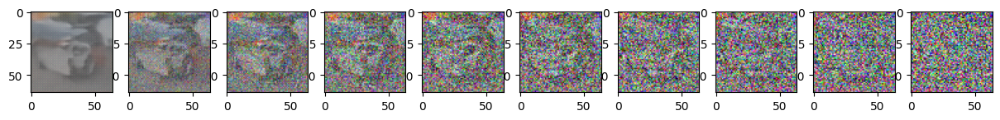

Epoch Progress:  14%|█▍        | 140/1000 [3:58:15<25:20:33, 106.09s/it]

Epoch 140 | step 000 Loss: 0.14155779778957367 


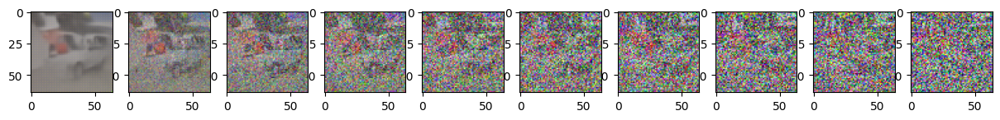

Epoch Progress:  14%|█▍        | 145/1000 [4:07:06<25:04:59, 105.61s/it]

Epoch 145 | step 000 Loss: 0.13025955855846405 


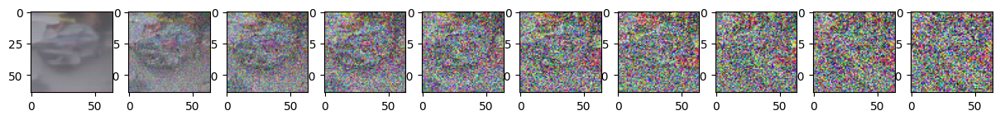

Epoch Progress:  15%|█▌        | 150/1000 [4:15:38<24:09:24, 102.31s/it]

Epoch 150 | step 000 Loss: 0.1236453652381897 


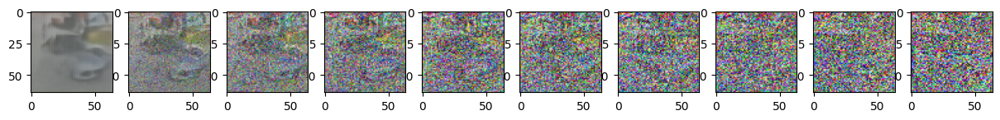

Epoch Progress:  16%|█▌        | 155/1000 [4:24:02<23:32:57, 100.33s/it]

Epoch 155 | step 000 Loss: 0.13563375174999237 


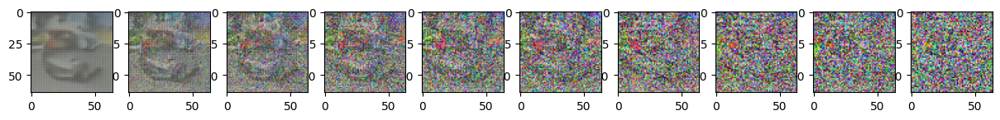

Epoch Progress:  16%|█▌        | 160/1000 [4:32:22<23:17:11, 99.80s/it] 

Epoch 160 | step 000 Loss: 0.13420434296131134 


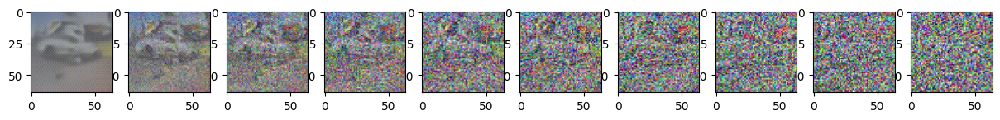

Epoch Progress:  16%|█▋        | 165/1000 [4:40:46<23:12:08, 100.03s/it]

Epoch 165 | step 000 Loss: 0.1340087354183197 


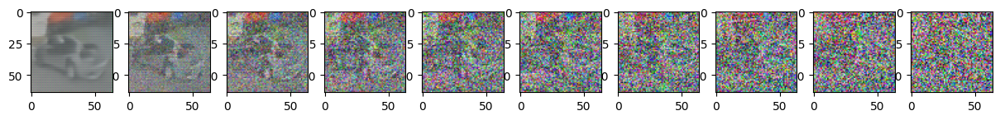

Epoch Progress:  17%|█▋        | 170/1000 [4:49:06<22:57:56, 99.61s/it] 

Epoch 170 | step 000 Loss: 0.12670324742794037 


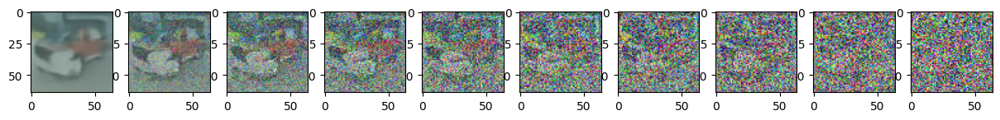

Epoch Progress:  18%|█▊        | 175/1000 [4:57:31<23:00:20, 100.39s/it]

Epoch 175 | step 000 Loss: 0.14114733040332794 


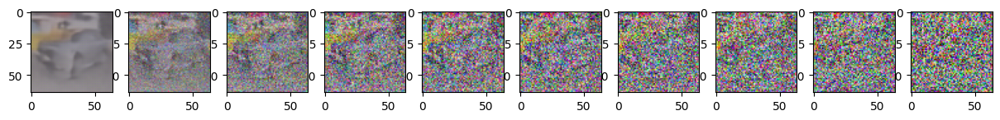

Epoch Progress:  18%|█▊        | 180/1000 [5:05:58<23:00:17, 101.00s/it]

Epoch 180 | step 000 Loss: 0.13255062699317932 


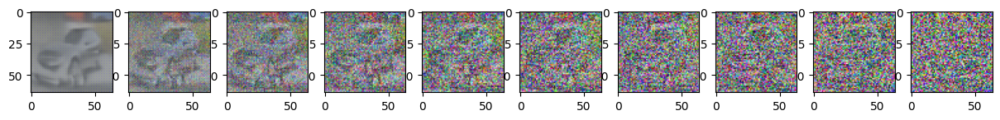

Epoch Progress:  18%|█▊        | 185/1000 [5:14:23<22:47:14, 100.66s/it]

Epoch 185 | step 000 Loss: 0.11961250007152557 


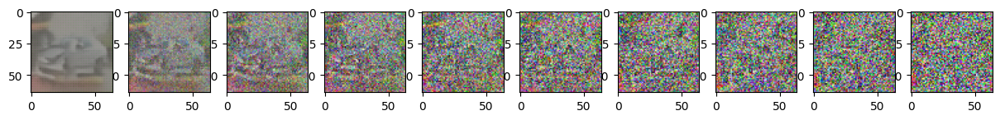

Epoch Progress:  19%|█▉        | 190/1000 [5:22:46<22:31:05, 100.08s/it]

Epoch 190 | step 000 Loss: 0.1309957504272461 


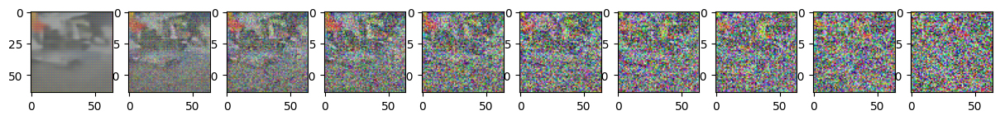

Epoch Progress:  20%|█▉        | 195/1000 [5:31:09<22:19:19, 99.83s/it] 

Epoch 195 | step 000 Loss: 0.12553884088993073 


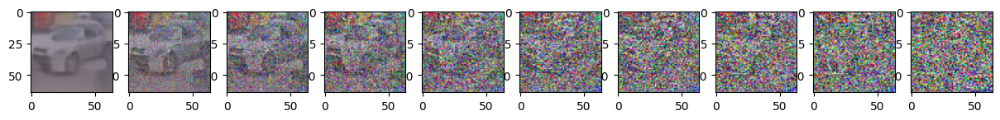

Epoch Progress:  20%|██        | 200/1000 [5:39:29<22:02:52, 99.22s/it] 

Epoch 200 | step 000 Loss: 0.12986604869365692 


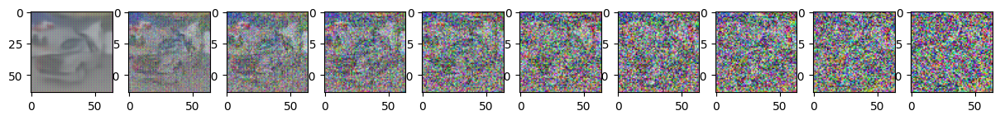

Epoch Progress:  20%|██        | 205/1000 [5:47:45<21:45:37, 98.54s/it] 

Epoch 205 | step 000 Loss: 0.12821558117866516 


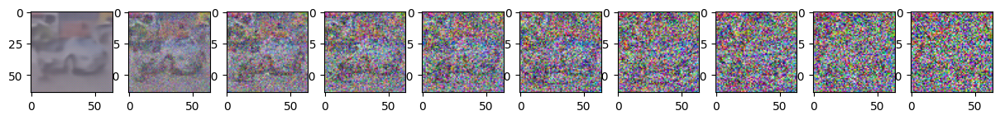

Epoch Progress:  21%|██        | 210/1000 [5:56:01<21:36:48, 98.49s/it]

Epoch 210 | step 000 Loss: 0.12614558637142181 


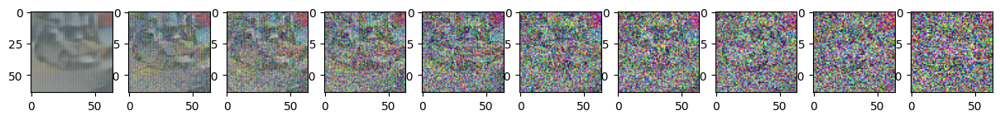

Epoch Progress:  22%|██▏       | 215/1000 [6:04:14<21:28:30, 98.48s/it]

Epoch 215 | step 000 Loss: 0.13451263308525085 


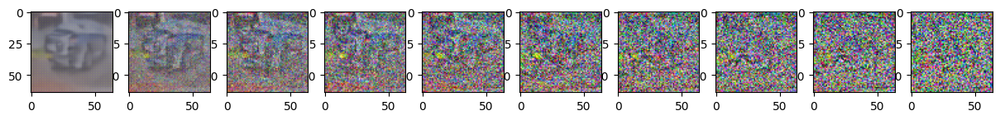

Epoch Progress:  22%|██▏       | 220/1000 [6:12:35<21:33:01, 99.46s/it]

Epoch 220 | step 000 Loss: 0.11645965278148651 


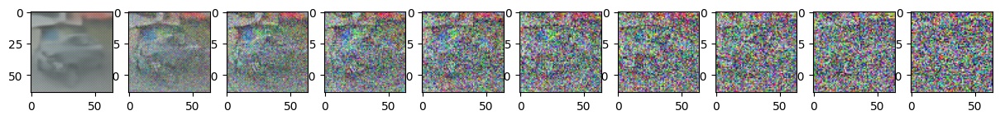

Epoch Progress:  22%|██▎       | 225/1000 [6:20:55<21:25:01, 99.49s/it] 

Epoch 225 | step 000 Loss: 0.1307620108127594 


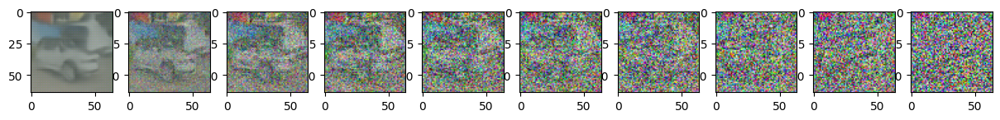

Epoch Progress:  23%|██▎       | 230/1000 [6:29:16<21:21:46, 99.88s/it] 

Epoch 230 | step 000 Loss: 0.13564185798168182 


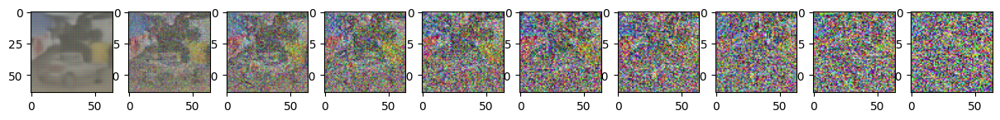

Epoch Progress:  24%|██▎       | 235/1000 [6:37:39<21:11:38, 99.74s/it] 

Epoch 235 | step 000 Loss: 0.1273708939552307 


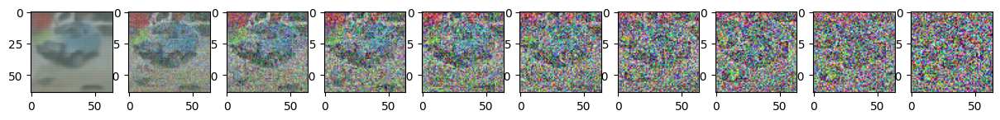

Epoch Progress:  24%|██▍       | 240/1000 [6:45:55<20:50:41, 98.74s/it] 

Epoch 240 | step 000 Loss: 0.12676958739757538 


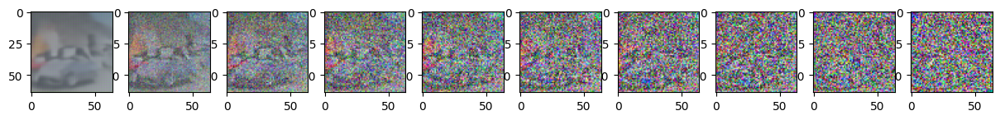

Epoch Progress:  24%|██▍       | 245/1000 [6:54:09<20:41:22, 98.65s/it]

Epoch 245 | step 000 Loss: 0.12279026210308075 


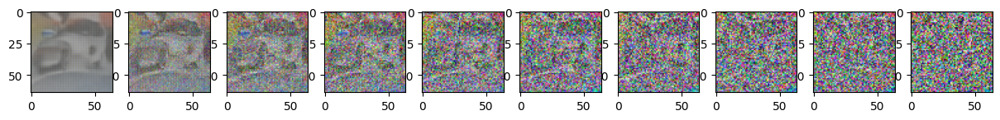

Epoch Progress:  25%|██▌       | 250/1000 [7:02:39<21:04:30, 101.16s/it]

Epoch 250 | step 000 Loss: 0.12181700766086578 


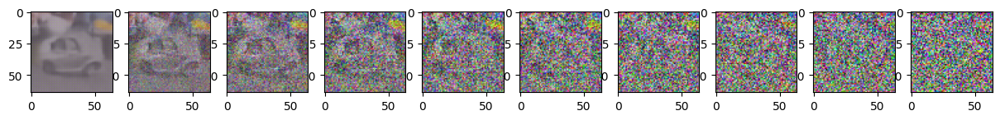

Epoch Progress:  26%|██▌       | 255/1000 [7:10:57<20:31:13, 99.16s/it] 

Epoch 255 | step 000 Loss: 0.12438052147626877 


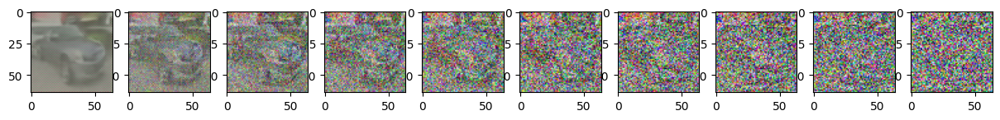

Epoch Progress:  26%|██▌       | 260/1000 [7:19:05<19:58:12, 97.15s/it]

Epoch 260 | step 000 Loss: 0.12862122058868408 


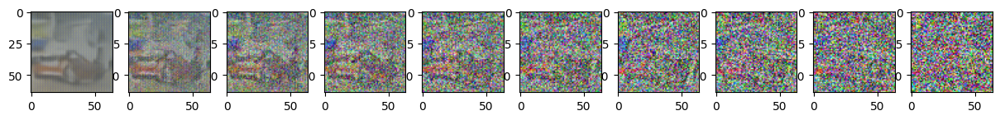

Epoch Progress:  26%|██▋       | 265/1000 [7:27:11<19:47:49, 96.96s/it]

Epoch 265 | step 000 Loss: 0.1304534524679184 


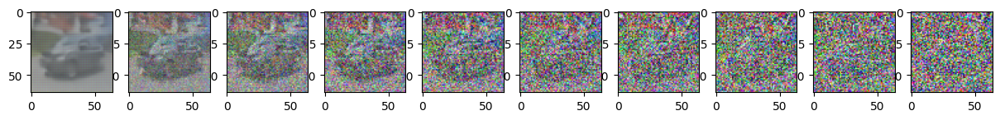

Epoch Progress:  27%|██▋       | 270/1000 [7:35:25<19:51:24, 97.92s/it]

Epoch 270 | step 000 Loss: 0.12761417031288147 


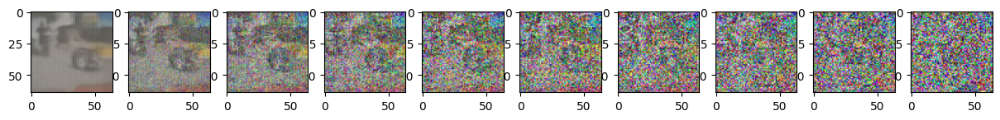

Epoch Progress:  28%|██▊       | 275/1000 [7:43:32<19:31:11, 96.93s/it]

Epoch 275 | step 000 Loss: 0.12491999566555023 


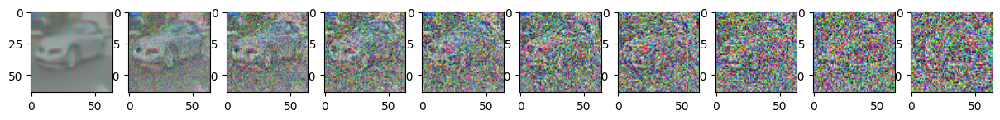

Epoch Progress:  28%|██▊       | 280/1000 [7:51:40<19:23:04, 96.92s/it]

Epoch 280 | step 000 Loss: 0.13236884772777557 


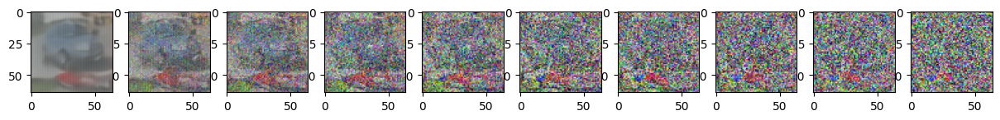

Epoch Progress:  28%|██▊       | 285/1000 [7:59:44<19:09:01, 96.42s/it]

Epoch 285 | step 000 Loss: 0.1255890130996704 


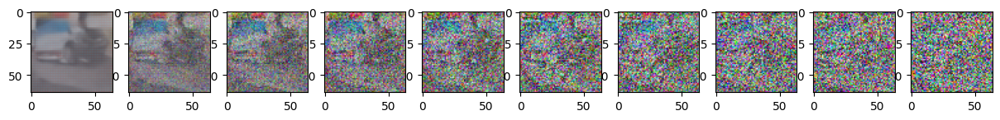

Epoch Progress:  29%|██▉       | 290/1000 [8:07:47<18:56:50, 96.07s/it]

Epoch 290 | step 000 Loss: 0.12472939491271973 


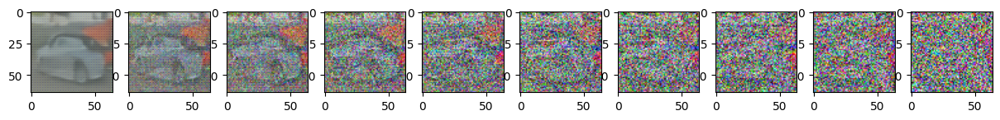

Epoch Progress:  30%|██▉       | 295/1000 [8:16:00<19:02:21, 97.22s/it]

Epoch 295 | step 000 Loss: 0.12687969207763672 


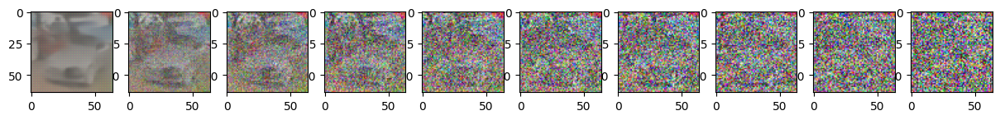

Epoch Progress:  30%|███       | 305/1000 [8:32:08<18:37:57, 96.51s/it]

Epoch 305 | step 000 Loss: 0.12955348193645477 


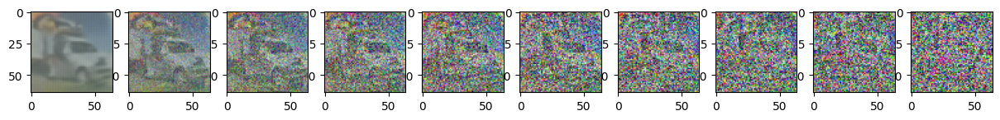

Epoch Progress:  31%|███       | 310/1000 [8:40:15<18:34:41, 96.93s/it]

Epoch 310 | step 000 Loss: 0.11881419271230698 


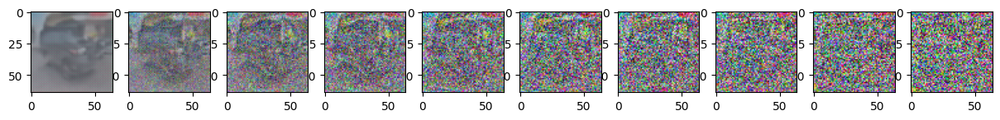

Epoch Progress:  32%|███▏      | 315/1000 [8:48:27<18:35:31, 97.71s/it]

Epoch 315 | step 000 Loss: 0.12720739841461182 


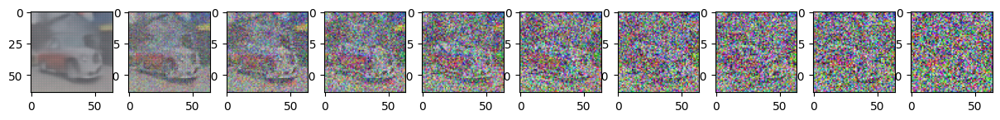

Epoch Progress:  32%|███▏      | 320/1000 [8:56:30<18:12:12, 96.37s/it]

Epoch 320 | step 000 Loss: 0.13306036591529846 


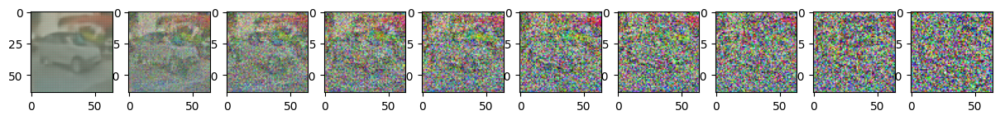

Epoch Progress:  32%|███▎      | 325/1000 [9:04:34<18:05:14, 96.47s/it]

Epoch 325 | step 000 Loss: 0.12186916172504425 


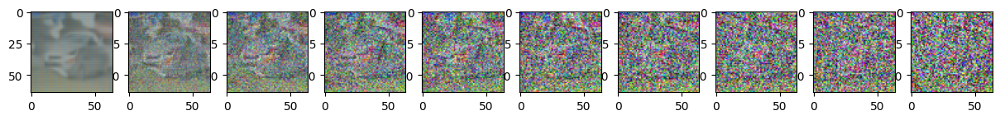

Epoch Progress:  33%|███▎      | 330/1000 [9:12:49<18:20:35, 98.56s/it]

Epoch 330 | step 000 Loss: 0.13249659538269043 


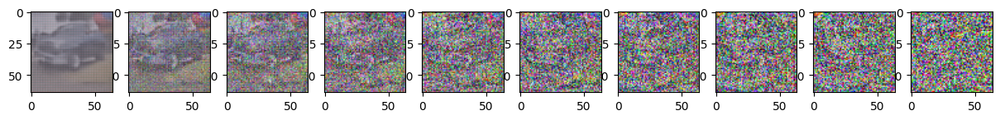

Epoch Progress:  34%|███▎      | 335/1000 [9:21:09<18:20:37, 99.30s/it]

Epoch 335 | step 000 Loss: 0.1245369166135788 


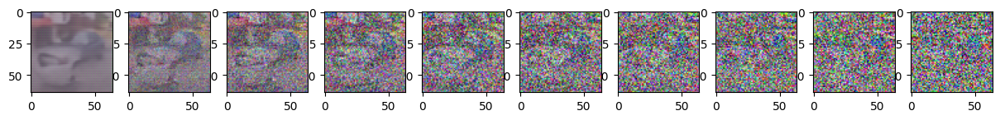

Epoch Progress:  34%|███▍      | 340/1000 [9:29:31<18:15:47, 99.62s/it] 

Epoch 340 | step 000 Loss: 0.13065294921398163 


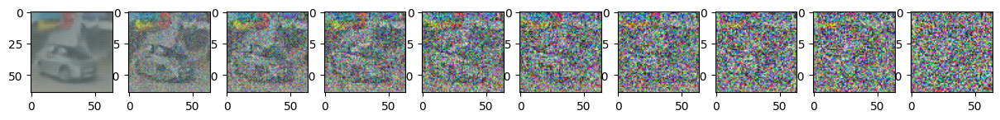

Epoch Progress:  34%|███▍      | 345/1000 [9:37:52<18:08:22, 99.70s/it] 

Epoch 345 | step 000 Loss: 0.12899482250213623 


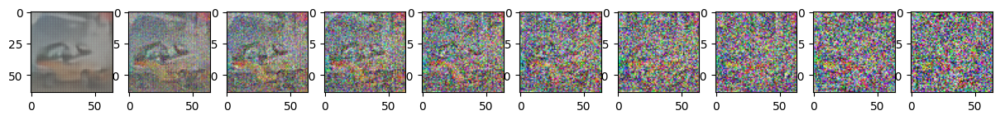

Epoch Progress:  35%|███▌      | 350/1000 [9:46:02<17:34:37, 97.35s/it] 

Epoch 350 | step 000 Loss: 0.11966976523399353 


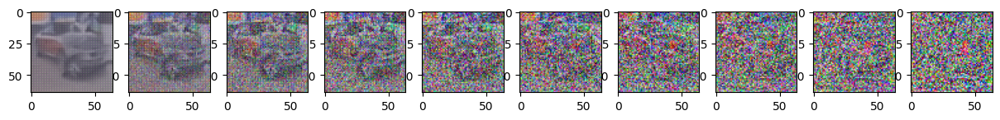

Epoch Progress:  36%|███▌      | 355/1000 [9:54:07<17:18:37, 96.62s/it]

Epoch 355 | step 000 Loss: 0.1319371908903122 


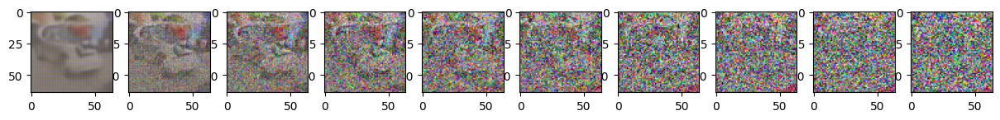

Epoch Progress:  36%|███▌      | 360/1000 [10:02:06<16:58:59, 95.53s/it]

Epoch 360 | step 000 Loss: 0.1217883974313736 


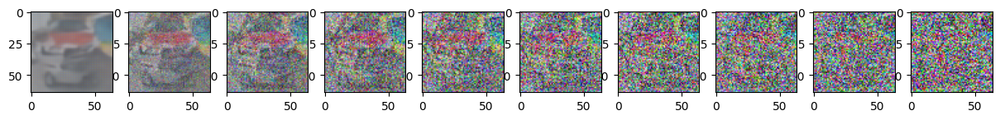

Epoch Progress:  36%|███▋      | 365/1000 [10:10:09<16:58:05, 96.20s/it]

Epoch 365 | step 000 Loss: 0.12648016214370728 


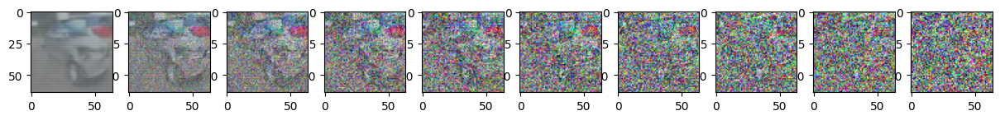

Epoch Progress:  37%|███▋      | 370/1000 [10:18:11<16:48:25, 96.04s/it]

Epoch 370 | step 000 Loss: 0.11706282943487167 


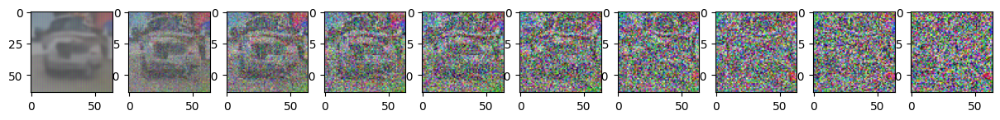

Epoch Progress:  38%|███▊      | 375/1000 [10:26:16<16:44:09, 96.40s/it]

Epoch 375 | step 000 Loss: 0.1195579469203949 


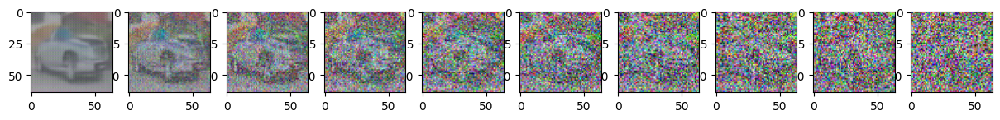

Epoch Progress:  38%|███▊      | 380/1000 [10:34:23<16:42:10, 96.98s/it]

Epoch 380 | step 000 Loss: 0.12539725005626678 


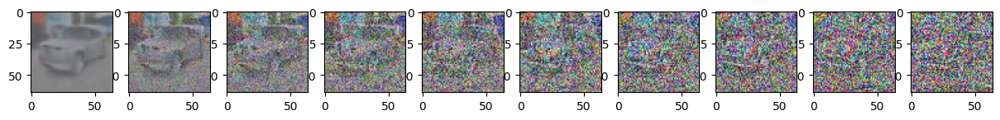

Epoch Progress:  39%|███▉      | 390/1000 [10:50:35<16:24:50, 96.87s/it]

Epoch 390 | step 000 Loss: 0.13289770483970642 


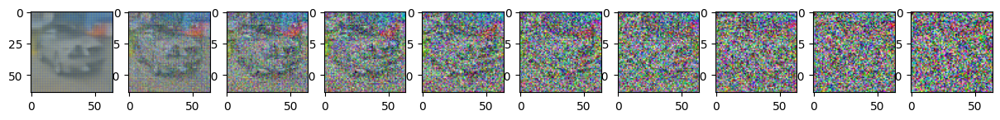

Epoch Progress:  40%|███▉      | 395/1000 [10:58:39<16:11:47, 96.38s/it]

Epoch 395 | step 000 Loss: 0.12014221400022507 


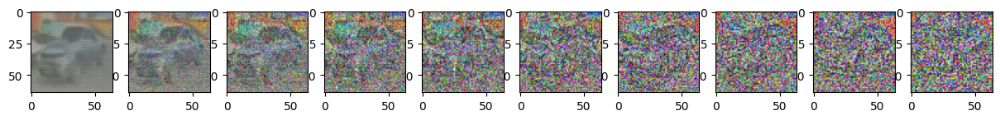

Epoch Progress:  40%|████      | 400/1000 [11:06:53<16:21:56, 98.19s/it]

Epoch 400 | step 000 Loss: 0.11686345189809799 


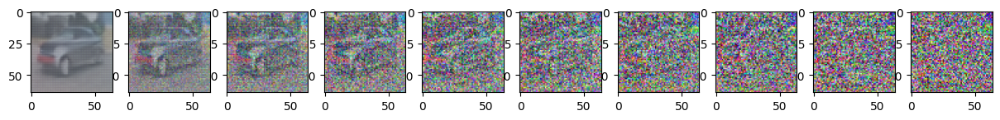

Epoch Progress:  40%|████      | 405/1000 [11:15:08<16:14:01, 98.22s/it]

Epoch 405 | step 000 Loss: 0.12751220166683197 


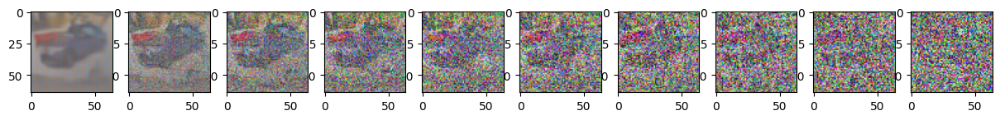

Epoch Progress:  41%|████      | 410/1000 [11:23:21<16:06:39, 98.30s/it]

Epoch 410 | step 000 Loss: 0.12405537813901901 


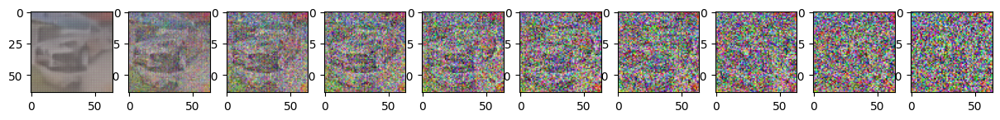

Epoch Progress:  42%|████▏     | 415/1000 [11:31:33<15:54:42, 97.92s/it]

Epoch 415 | step 000 Loss: 0.11887578666210175 


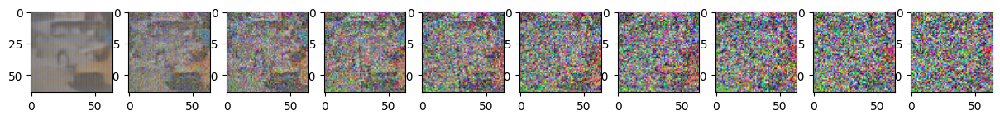

Epoch Progress:  42%|████▏     | 420/1000 [11:39:44<15:45:33, 97.82s/it]

Epoch 420 | step 000 Loss: 0.12246865034103394 


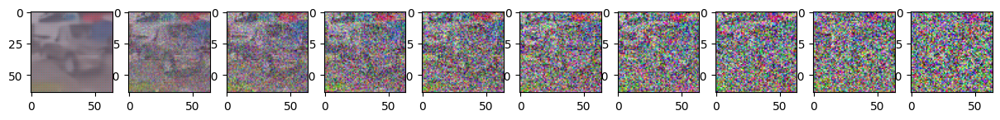

Epoch Progress:  42%|████▎     | 425/1000 [11:47:53<15:33:34, 97.42s/it]

Epoch 425 | step 000 Loss: 0.1252472996711731 


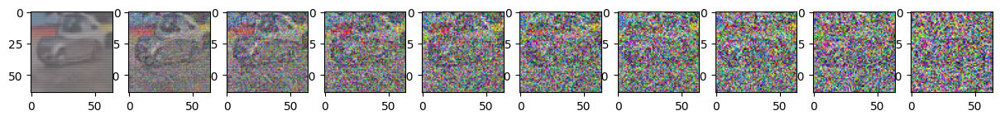

Epoch Progress:  43%|████▎     | 430/1000 [11:56:04<15:28:18, 97.72s/it]

Epoch 430 | step 000 Loss: 0.13501958549022675 


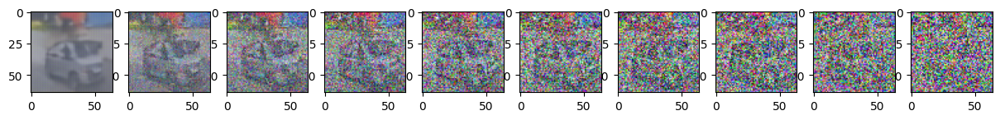

In [ ]:
from tqdm import tqdm  # 引入 tqdm
from torch.optim import Adam
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 1000  # 尝试更多的 epoch!

for epoch in tqdm(range(epochs), desc="Epoch Progress"):
    for step, batch in enumerate(dataloader):
        optimizer.zero_grad()

        t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
        loss = get_loss(model, batch[0], t)
        loss.backward()
        optimizer.step()

        if epoch % 5 == 0 and step == 0:
            print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
            sample_plot_image()

**欢迎大家点赞、关注以便及时收到更新提醒。**

接下来看简单的例子，后续在这个简单例子上继续深入，包括

- 自己的数据集怎么处理
- 多GPU训练
- 标签、文本控制图片生成
- 图片修复
- 以及开源比较火的Stable Diffusion 1.5/3
- 模型的部署推理等

## 保存整个模型：
这包括保存模型的结构和参数。不过，这种方式通常不推荐，因为它依赖于 Python 的 pickle 模块，可能在模型结构变化或不同的 Python 环境中遇到问题。

In [ ]:
import torch

# 保存模型实例
torch.save(model, 'model.pth')

## 加载整个模型：
如果你使用了保存整个模型的方法，可以这样加载：

In [ ]:
model = torch.load('model.pth')
model.eval()  # 切换到推理模式